# Common Errors when performing alignment. 

Often times there is high background, noise, or not enough corresponding z-slices to perform rigid image registration. Each of these issues are not necessarily mutually exclusive and can be solved by a number of approaches. It will be your job to figure out which solution is best. BUT it would be awesome if someone could automate these solutions (i.e. via anomoly detection).

# Using a binary mask to ignore high background values in registration

If you take a look at the image below, you will see that the features in the image are quite sparse. Thus when computing alignment, if we include the intensities of the entire image the optimizer will be biased to find a solution that aligns the white space instead of the actual features. 

In [1]:
from exm.io.io import nd2ToVol
fix = nd2ToVol('/mp/nas2/Chi Zhang/WORMSeq5_20220524/Code3/Code3.nd2',7)
mov = nd2ToVol('/mp/nas2/Chi Zhang/WORMSeq5_20220524/Code5/Code5.nd2',7)

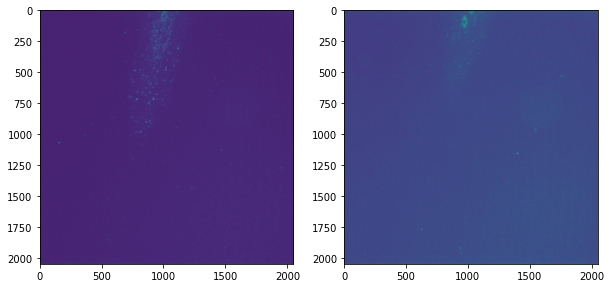

In [9]:
import matplotlib.pyplot as plt
%matplotlib inline
fig, ax = plt.subplots(1,2,figsize=(10,5))

ax[0].imshow(fix[350,:,:])
ax[1].imshow(mov[230,:,:])

Performing alignment on these two volumes does not initially work, but to improve results we use a simple mask on the fixed image by only sampling pixels that have features in them. 

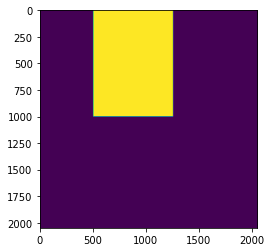

In [11]:
import numpy as np
fix_mask = np.zeros(fix.shape)
fix_mask[230:350,:1000,500:1250] = 1
plt.imshow(fix_mask[250,:,:])

In [16]:
from exm.align.build import alignBuild
from exm.config.utils import load_cfg

cfg = load_cfg()

cfg.defrost()
cfg.ALIGN.MaximumNumberOfIterations = '2000'
cfg.freeze()

align = alignBuild(cfg)
align.buildSitkTile()

# pass mask to align obj as uint8
tform = align.computeTransformMap(fix,mov,mask_fix=fix_mask.astype('uint8'))
result = align.warpVolume(mov,tform)

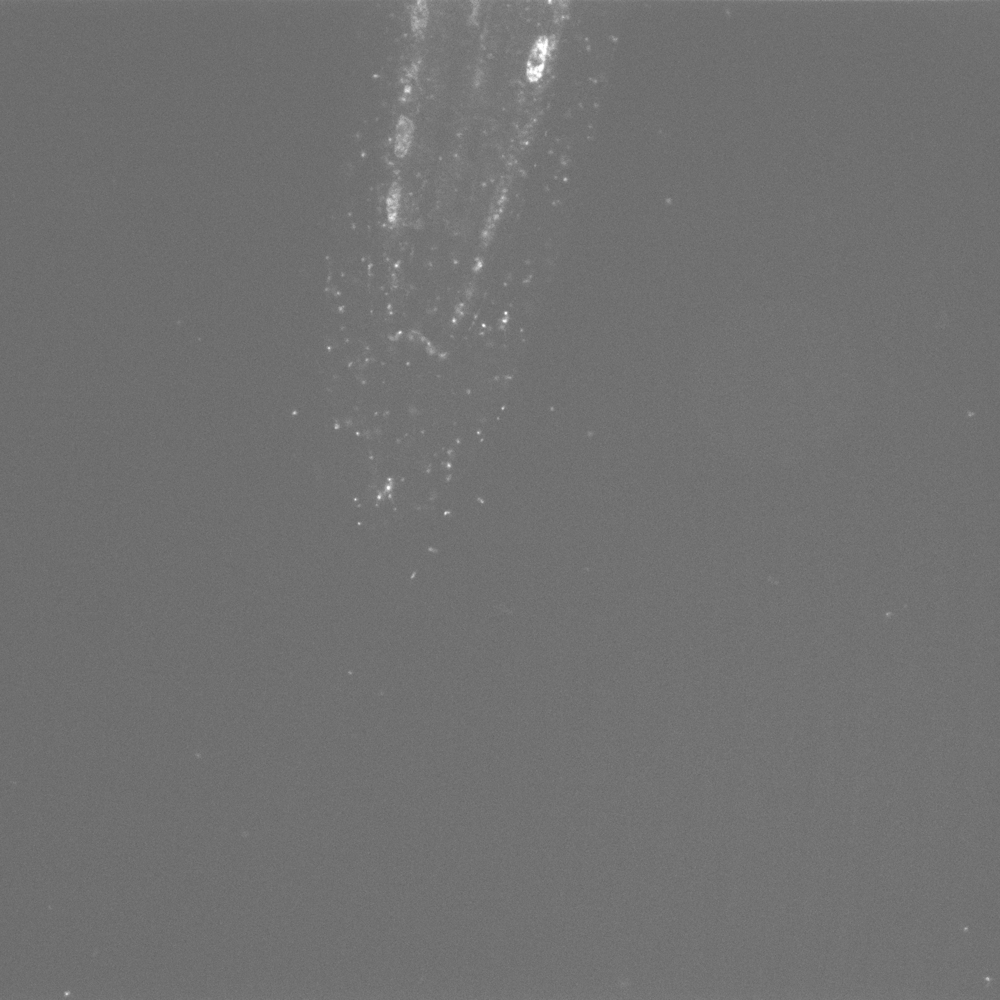

In [17]:
from exm.io.io import saveGif
saveGif(fix[300,:,:],result[300,:,:],filename='tmp.gif')

# Using SIFT and FLANN to detect corresponding z-slices

Sometimes the volumes we would like to register do not have enough mutual information between them to find the ground truth solution. Consider the figure below, the corresponding z-slices are separated by more than 50% of each volume. Thus not only the background will bias the optimizer, but the features that do not have anything to be registered will bias the solution as well.

![title](correspond_z.png)

One solution to this is depicted below, where we find the the z-slice of the moving image that correspond to the first z-slice of the fixed image, then crop the regions and perform registration with the cropped volume and modify the parameters. SIFT and FLANN allows us to find what the corresponding z-slices are through a metric, and it can be automated. 

![title](z_solution.png)

In [1]:
fix_path = '/mp/nas2/jlove/alignment/zebrafish/20220801/code0/90.h5'
mov_path = '/mp/nas2/ruihan/20220801_zebrafish/20220803_Code3/Channel405 SD_Seq0004.nd2'

In [8]:
import h5py
fix = np.asarray(h5py.File(fix_path)['main'])
mov = nd2ToVol(mov_path, 90)

In [10]:
cfg = load_cfg()
align = alignBuild(cfg)
align.buildSitkTile()

In [11]:
# we can also compute the mask via otsu's method, then performing median filtering and dilation
fix_mask = align.computeOtsuMask(fix)
# lets check to see if its just a mask issue
tform = align.computeTransformMap(fix, mov, mask_fix = fix_mask.astype('uint8'))
result = align.warpVolume(mov,tform)

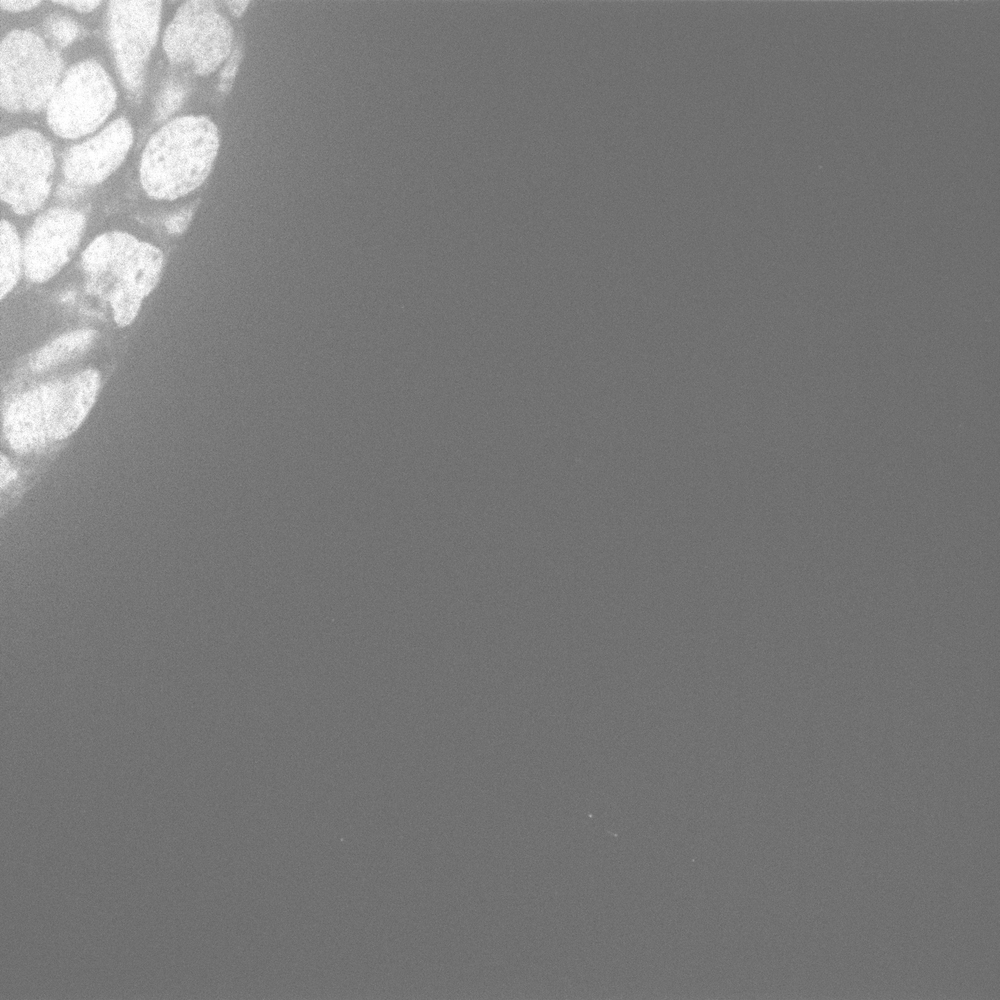

In [14]:
#clearly didn't work so let's try SIFT and Flann
saveGif(fix[0,:,:], result[0,:,:], 'tmp.gif')

In [15]:
fix_slice = fix[0,:,:]
dists=[]
for z in mov[50:120,:,:]:
    #this function finds the minimum distance between a set of keypoints in the fixed and moving image, and also returns the 2-norm of all distances
    norm, dist = align.computeMinFlann(fix_slice,z)
    dists.append(dist)

Text(0, 0.5, 'Distance in arbitrary units')

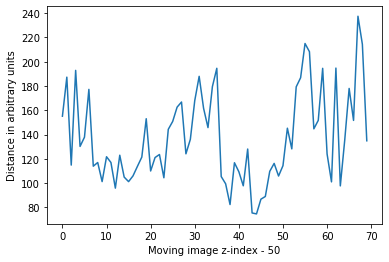

In [18]:
plt.plot(dists)
plt.xlabel('Moving image z-index - 50')
plt.ylabel('Distance in arbitrary units')

As you can see there are multiple solutions that might be possible, so to handle this ambiguity we take some number of candidates, index the moving volume at them, and take the mutual information between that slice and the first fixed slice. We then crop the moving and fixed volume based on whichever moving slice returns the max mutual information. 

In [21]:
max_mi, max_ind = align.computeMaxMI(fix_slice,mov,dists,z_min = 50)

Text(0.5, 1.0, 'mov at z = 96')

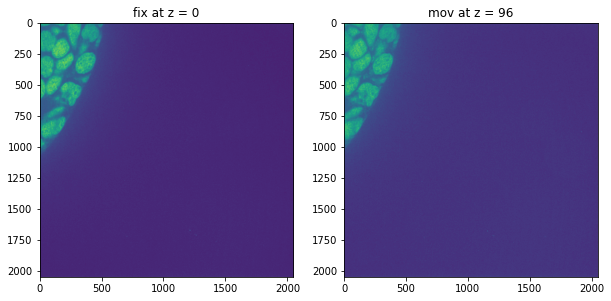

In [26]:
fig, ax = plt.subplots(1,2,figsize=(10,20))

ax[0].imshow(fix[0,:,:])
ax[0].set_title('fix at z = 0')
ax[1].imshow(mov[max_ind,:,:])
ax[1].set_title(f'mov at z = {max_ind}')

So things seem to work quite well, and this is promising. One thing to note is that this is often an approximate solution (at least according to checking things qualitativley). So if things aren't perfect after inspecting, but good enough, then you can proceed with registration. 

In [27]:
ROI_min_fix = [0,0,0]
ROI_max_fix = [mov.shape[0]-max_ind,2048,2048]

ROI_min_mov = [max_ind,0,0]
ROI_max_mov = [mov.shape[0],2048,2048]

# add the mask because we've computed it already, note the shape modificaiton
# mask is really only necessary in this case when there is noise, but use it anyway
tform, result = align.localToGlobalTform(fix, mov,
                                        ROI_min_fix,
                                        ROI_max_fix,
                                        ROI_min_mov,
                                        ROI_max_mov, mask_fix=fix_mask[:mov.shape[0]-max_ind].astype(np.uint8))

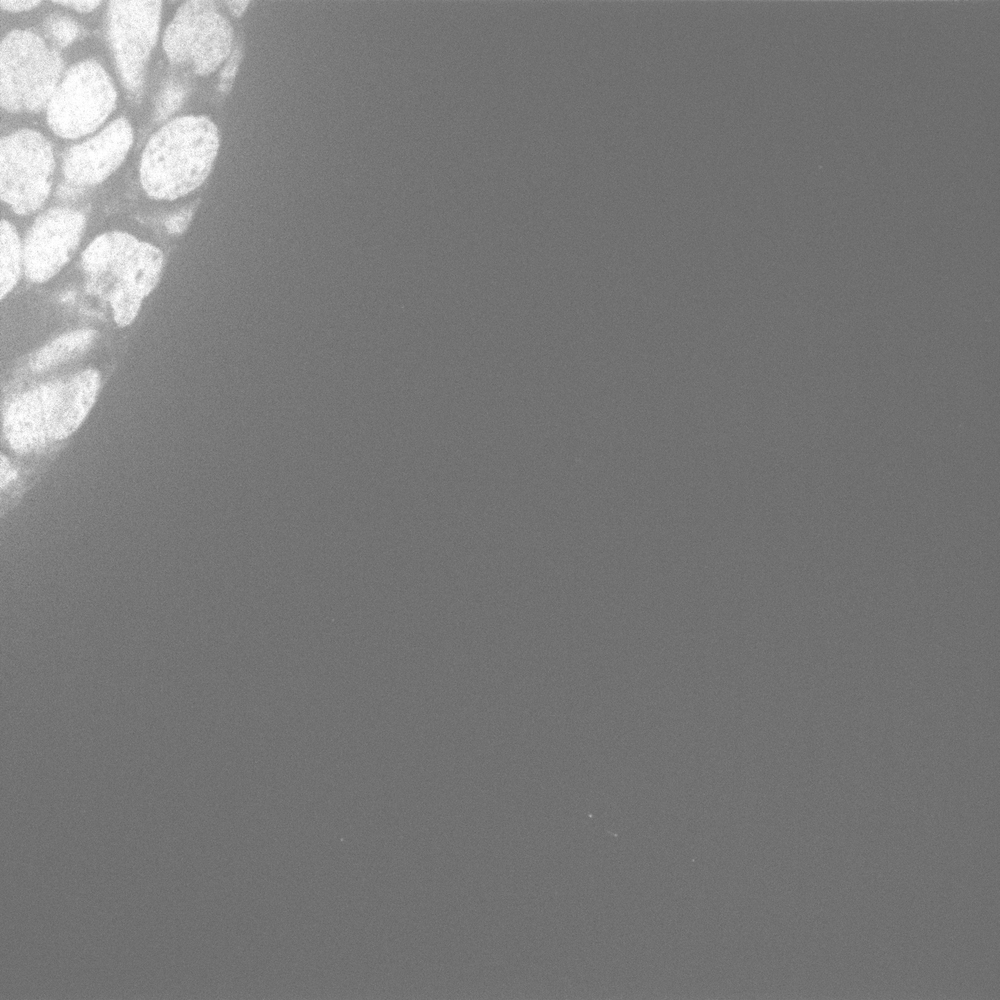

In [28]:
saveGif(fix[0,:,:], result[0,:,:], 'tmp.gif')

Yay! It worked!!!

# Using Segmented Masks and Dice Similarity to infer Ground Truth

Sometimes FLANN doesn't find the right corresponding z-slice

In [30]:
fix = nd2ToVol('/mp/nas2/ruihan/20220627_zebrafish/20220627_Code0/Channel405 SD_Seq0004.nd2',50)
mov = nd2ToVol('/mp/nas2/ruihan/20220627_zebrafish/20220705_Code4/Channel405 SD_Seq0004.nd2',50)

In [31]:
fix_slice = fix[0,:,:]
dists=[]
for z in mov[50:120,:,:]:
    #this function finds the minimum distance between a set of keypoints in the fixed and moving image, and also returns the 2-norm of all distances
    norm, dist = align.computeMinFlann(fix_slice,z)
    dists.append(dist)

Text(0, 0.5, 'Distance in arbitrary units')

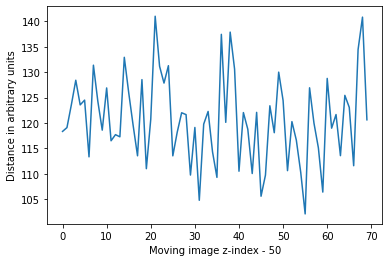

In [32]:
plt.plot(dists)
plt.xlabel('Moving image z-index - 50')
plt.ylabel('Distance in arbitrary units')

In [33]:
max_mi, max_ind = align.computeMaxMI(fix_slice,mov,dists,z_min = 50)

Text(0.5, 1.0, 'mov at z = 95')

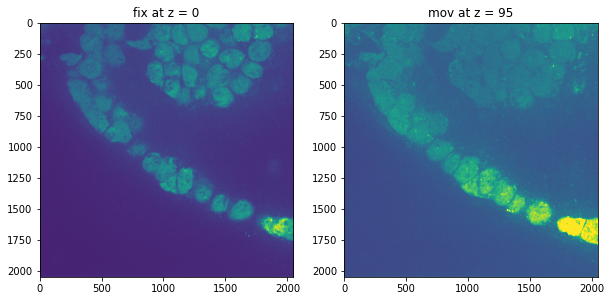

In [46]:
fig, ax = plt.subplots(1,2,figsize=(10,20))

ax[0].imshow(fix[0,:,:], vmax = 300)
ax[0].set_title('fix at z = 0')
ax[1].imshow(mov[max_ind,:,:], vmax = 200)
ax[1].set_title(f'mov at z = {max_ind}')

So instead, we can look at the overall structure of the image via a binary mask and use this information to infer ground truth. We use a dice similarity coefficient between two masks to compute a metric, and the index with the max dice similarity is the corresponding z-slice.

In [38]:
fix_mask = align.computeOtsuMask(fix[0,:,:])
dices = []
for z in mov[50:120,:,:]:
    #compute binary mask for moving
    mov_mask = align.computeOtsuMask(z)
    #then task dice sim
    dice = align.diceCoefficient(fix_mask, mov_mask)
    dices.append(dice)

Text(0, 0.5, 'Dice similarity')

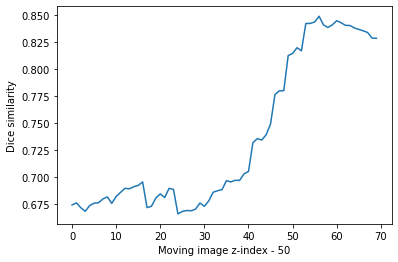

In [39]:
plt.plot(dices)
plt.xlabel('Moving image z-index - 50')
plt.ylabel('Dice similarity')

Text(0.5, 1.0, 'mov at z = 106')

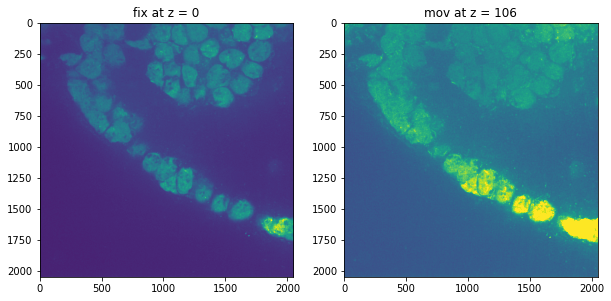

In [44]:
fig, ax = plt.subplots(1,2,figsize=(10,20))

ax[0].imshow(fix[0,:,:], vmax = 300)
ax[0].set_title('fix at z = 0')
#note add 50 to index
ax[1].imshow(mov[np.argmax(dices)+50,:,:], vmax = 175)
ax[1].set_title(f'mov at z = {np.argmax(dices)+50}')

In [47]:
max_ind = np.argmax(dices)+50

ROI_min_fix = [0,0,0]
ROI_max_fix = [mov.shape[0]-max_ind,2048,2048]

ROI_min_mov = [max_ind,0,0]
ROI_max_mov = [mov.shape[0],2048,2048]

# note no mask used
tform, result = align.localToGlobalTform(fix, mov,
                                        ROI_min_fix,
                                        ROI_max_fix,
                                        ROI_min_mov,
                                        ROI_max_mov)

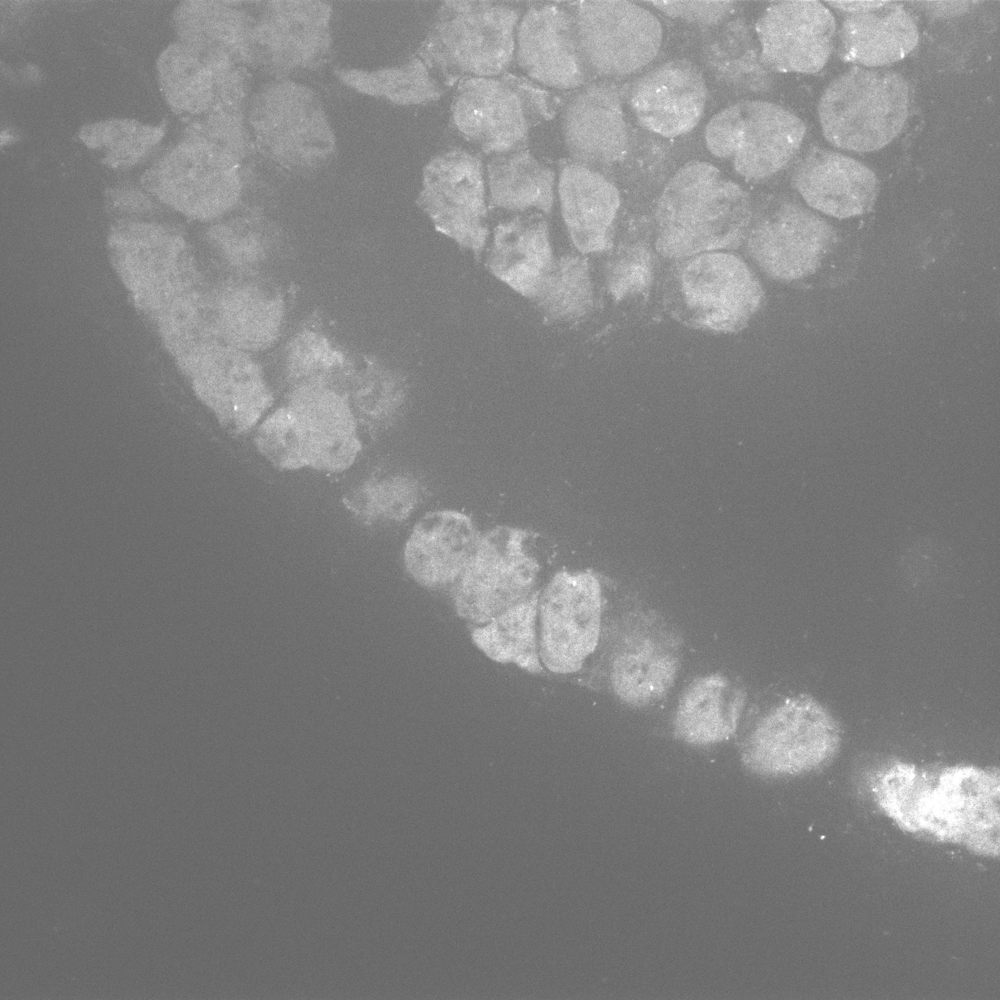

In [48]:
saveGif(fix[0,:,:], result[0,:,:], 'tmp.gif')

Once again things seem to work now 